In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, f_oneway

from statsmodels.stats.multitest import multipletests
from statsmodels.stats.multicomp import pairwise_tukeyhsd
import plotly.express as px
import seaborn as sns
from sklearn import decomposition
import pickle

# 1. Parse File (Remove in Solution Notebook)

In [2]:
with open('../Data/GSE8685_family.soft') as f:
    lines=f.readlines()
    
    on_expression_table=False
    on_platform_table=False
    on_sample=False
    
    sample=''
    sample_key={}
    
    probe_key={}    
    expression_table={}
    p_val_table={}
    transcript_table={}
    abs_call_table={}
    
    for line in lines:
        
        line=line.strip()
        
        if line=='!platform_table_begin':
            on_platform_table=True
            continue
            
        elif line=='!platform_table_end':
            on_platform_table=False
            continue
            
        elif line=='!sample_table_begin':
            on_expression_table=True
            continue
            
        elif line=='!sample_table_end':
            on_expression_table=False
            continue
            
        elif line.split(' = ')[0]=='^SAMPLE':
            sample=line.split(' = ')[1]
            expression_table[sample]={}
            transcript_table[sample]={}
            p_val_table[sample]={}
            abs_call_table[sample]={}
            continue
            
        elif line.split(' = ')[0]=='!Sample_title':
            sample_key[sample]=line.split(' = ')[1]
            continue
        
        line=line.strip().split('\t')
        
        if on_platform_table:
            if len(line)<10:
                if line[5]=='':
                    print(line)
                probe_key[line[0]]=line[5]
                continue
                
            else:
                gene_ids=line[10].split(' /// ')

                probe_key[line[0]]=gene_ids
                continue
            
        elif on_expression_table:
            if sample=='':
                print(line)
            if line[0]=='ID_REF':
                continue
            else:
                value=line[1]
                p_val=line[3]
                abs_call=line[2]
                probe_id=line[0]
                gene_names=probe_key[probe_id]
                if type(gene_names)==list:
                    for gene_name in gene_names:
                        if not gene_name in expression_table[sample]:
                            expression_table[sample][gene_name]=[float(value)]
                        else:
                            expression_table[sample][gene_name].append(float(value))
                        
                else:
                    if not gene_names in expression_table[sample]:
                        expression_table[sample][gene_names]=[float(value)]
                    else:
                        expression_table[sample][gene_names].append(float(value))
                p_val_table[sample][probe_id]=float(p_val) 
                abs_call_table[sample][probe_id]= 1 if abs_call=='P' else 0
                transcript_table[sample][probe_id]=float(value)

In [3]:
sample_key

{'GSM215347': 'Sez-4 cells starved of IL-2 biological rep1',
 'GSM215348': 'Sez-4 cells starved of IL-2 biological rep2',
 'GSM215349': 'Sez-4 cells starved of IL-2 biological rep3',
 'GSM215350': 'Sez-4 cells starved of IL-2 and activated with IL-2 biological rep1',
 'GSM215351': 'Sez-4 cells starved of IL-2 and activated with IL-2 biological rep2',
 'GSM215352': 'Sez-4 cells starved of IL-2 and activated with IL-2 biological rep3',
 'GSM215353': 'Sez-4 cells starved of IL-2 and activated with IL-15 biological rep1',
 'GSM215354': 'Sez-4 cells starved of IL-2 and activated with IL-15 biological rep2',
 'GSM215355': 'Sez-4 cells starved of IL-2 and activated with IL-15 biological rep3',
 'GSM215356': 'Sez-4 cells starved of IL-2 and activated with IL-21 biological rep1',
 'GSM215357': 'Sez-4 cells starved of IL-2 and activated with IL-21 biological rep2',
 'GSM215358': 'Sez-4 cells starved of IL-2 and activated with IL-21 biological rep3'}

In [4]:
sample_key_abb={
    'GSM215347':'Control 1',
    'GSM215348':'Control 2',
    'GSM215349':'Control 3',
    'GSM215350':'Activated with IL2 rep 1',
    'GSM215351':'Activated with IL2 rep 2',
    'GSM215352':'Activated with IL2 rep 3',
    'GSM215353':'Activated with IL15 rep 1',
    'GSM215354':'Activated with IL15 rep 2',
    'GSM215355':'Activated with IL15 rep 3',
    'GSM215356':'Activated with IL21 rep 1',
    'GSM215357':'Activated with IL21 rep 2',
    'GSM215358':'Activated with IL21 rep 3'
}

experimental_groups={
    'Control': ['GSM215347', 'GSM215348', 'GSM215349'],
    'IL2': ['GSM215350', 'GSM215351', 'GSM215352'],
    'IL15': ['GSM215353', 'GSM215354', 'GSM215355'],
    'IL21': ['GSM215356', 'GSM215357', 'GSM215358'],
}



In [5]:
transcript_df=pd.DataFrame(transcript_table).dropna()

In [6]:
transcript_df

,GSM215347,GSM215348,GSM215349,GSM215350,GSM215351,GSM215352,GSM215353,GSM215354,GSM215355,GSM215356,GSM215357,GSM215358
AFFX-BioB-5_at,391.1,270.5,282.1,233.1,229.4,203.7,220.9,217.7,190.6,248.1,183.1,202.4
AFFX-BioB-M_at,474.3,318.8,344.8,322.9,318.8,361.5,288.8,277.8,269.5,360.0,281.0,295.8
AFFX-BioB-3_at,305.3,264.6,236.6,234.4,233.2,217.2,236.6,192.8,173.5,235.2,247.1,203.7
AFFX-BioC-5_at,864.9,700.0,657.2,554.0,610.1,620.6,548.8,639.6,529.3,627.7,575.6,555.6
AFFX-BioC-3_at,916.9,723.8,728.9,578.3,696.8,721.2,619.8,551.5,607.0,708.7,682.6,714.9
...,...,...,...,...,...,...,...,...,...,...,...,...
1570644_at,35.3,45.5,4.2,34.0,3.6,27.5,24.8,30.7,24.3,37.9,12.9,47.3
1570645_at,17.4,27.4,13.2,31.4,17.4,29.0,19.1,37.5,13.7,39.2,11.1,4.7
1570650_at,9.8,10.8,5.3,20.9,40.6,5.2,1.8,13.2,11.5,32.6,17.2,29.9
1570651_at,9.9,33.0,32.0,7.3,45.0,19.7,18.8,8.7,28.9,24.0,29.0,32.3


In [7]:
probe_key

{'ID': ['Gene Symbol'],
 '1007_s_at': ['DDR1', 'MIR4640'],
 '1053_at': ['RFC2'],
 '117_at': ['HSPA6'],
 '121_at': ['PAX8'],
 '1255_g_at': ['GUCA1A'],
 '1294_at': ['MIR5193', 'UBA7'],
 '1316_at': ['THRA'],
 '1320_at': ['PTPN21'],
 '1405_i_at': ['CCL5'],
 '1431_at': ['CYP2E1'],
 '1438_at': ['EPHB3'],
 '1487_at': ['ESRRA'],
 '1494_f_at': ['CYP2A6'],
 '1552256_a_at': ['SCARB1'],
 '1552257_a_at': ['TTLL12'],
 '1552258_at': ['LINC00152', 'LOC101930489'],
 '1552261_at': ['WFDC2'],
 '1552263_at': ['MAPK1'],
 '1552264_a_at': ['MAPK1'],
 '1552266_at': ['ADAM32'],
 '1552269_at': ['SPATA17'],
 '1552271_at': ['PRR22'],
 '1552272_a_at': ['PRR22'],
 '1552274_at': ['PXK'],
 '1552275_s_at': ['PXK'],
 '1552276_a_at': ['VPS18'],
 '1552277_a_at': ['MSANTD3'],
 '1552278_a_at': ['SLC46A1'],
 '1552279_a_at': ['SLC46A1'],
 '1552280_at': ['TIMD4'],
 '1552281_at': ['SLC39A5'],
 '1552283_s_at': ['ZDHHC11', 'ZDHHC11B'],
 '1552286_at': ['ATP6V1E2'],
 '1552287_s_at': ['AFG3L1P'],
 '1552288_at': ['CILP2'],
 '1552289

# 2. Retain only transcripts with present calls in all members of at least one condition

In [8]:
abs_call_df=pd.DataFrame(abs_call_table)
abs_call_df

,GSM215347,GSM215348,GSM215349,GSM215350,GSM215351,GSM215352,GSM215353,GSM215354,GSM215355,GSM215356,GSM215357,GSM215358
AFFX-BioB-5_at,1,1,1,1,1,1,1,1,1,1,1,1
AFFX-BioB-M_at,1,1,1,1,1,1,1,1,1,1,1,1
AFFX-BioB-3_at,1,1,1,1,1,1,1,1,1,1,1,1
AFFX-BioC-5_at,1,1,1,1,1,1,1,1,1,1,1,1
AFFX-BioC-3_at,1,1,1,1,1,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
1570644_at,0,0,0,0,0,1,0,1,0,0,0,0
1570645_at,0,0,0,0,0,1,0,1,0,0,0,0
1570650_at,0,0,0,0,0,0,0,0,0,0,0,0
1570651_at,0,0,0,0,0,0,0,0,0,0,0,0


In [9]:
present_transcripts=set()

for transcript in abs_call_df.index:
    for condition in experimental_groups:
        
        if abs_call_df.loc[transcript, experimental_groups[condition]].sum()==3:
            present_transcripts.add(transcript)
            break

In [10]:
len(present_transcripts)

21794

In [11]:
present_transcripts_df=transcript_df.loc[present_transcripts]
present_transcripts_df.shape

(21794, 12)

# 3. PCA

In [14]:
pca=decomposition.PCA(n_components=3)
components=pca.fit_transform(present_transcripts_df.T.values)
components_df=pd.DataFrame(components, index=present_transcripts_df.T.index)

#### We want a high combined explained variance ratio. If there we can't get a high explained variance ratio within the first 2-3 components, we should choose a different method

In [15]:
pca.explained_variance_ratio_

array([0.45630541, 0.2501321 , 0.09988393])

In [203]:
pca.explained_variance_ratio_.sum()

0.8063214388578126

In [16]:
components_df

,0,1,2
GSM215347,23831.982960,-32517.375235,-11728.749816
GSM215348,35399.323386,7889.080925,-13387.449424
GSM215349,32408.720834,18537.753986,-5567.542190
GSM215350,-22081.898352,9075.907357,839.276408
GSM215351,-13923.648681,37853.958132,-6463.869056
GSM215352,-26937.010896,-1502.911633,-8705.883299
GSM215353,-27011.797039,-24685.712420,-3445.909581
GSM215354,-23786.237514,-7894.898685,-10249.741794
GSM215355,-23336.401186,4719.129355,15019.216225
GSM215356,16493.197651,-3800.497565,10188.367353


### 3D Scatterplot - visualize PCA

In [17]:
from mpl_toolkits.mplot3d import Axes3D

In [18]:
experimental_groups

{'Control': ['GSM215347', 'GSM215348', 'GSM215349'],
 'IL2': ['GSM215350', 'GSM215351', 'GSM215352'],
 'IL15': ['GSM215353', 'GSM215354', 'GSM215355'],
 'IL21': ['GSM215356', 'GSM215357', 'GSM215358']}

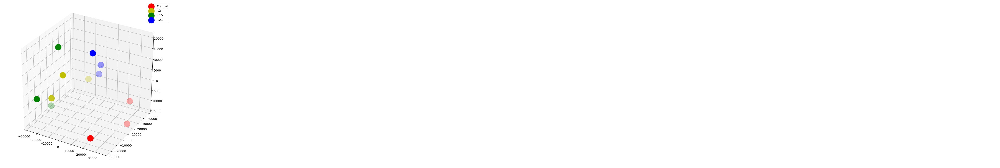

In [19]:
fig=plt.figure(figsize=(10,10), dpi=100)
ax=fig.gca(projection='3d')
for i, j in zip(experimental_groups, 'rygb'):
    xs=components_df.loc[experimental_groups[i], 0].values
    ys=components_df.loc[experimental_groups[i], 1].values
    zs=components_df.loc[experimental_groups[i], 2]
    ax.scatter(xs, ys, zs, c=j, s=400)
    
ax.legend(labels=['Control', 'IL2', 'IL15', 'IL21'])
plt.show()
fig.savefig('../Results/3d_pca.png')

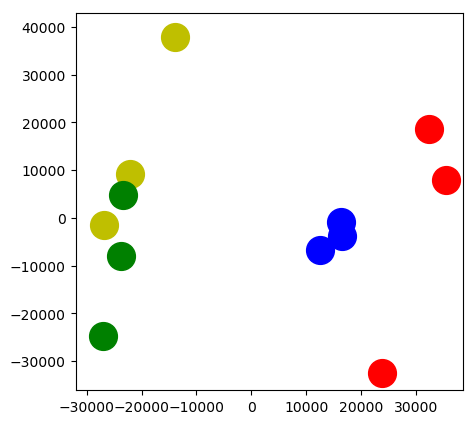

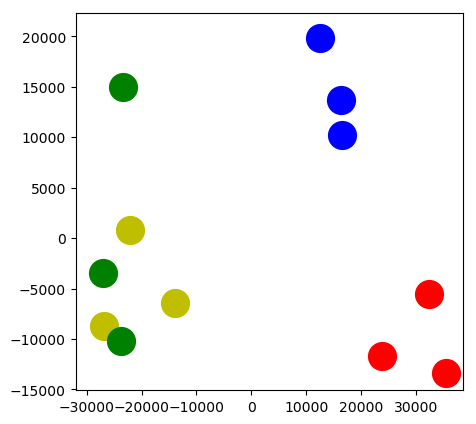

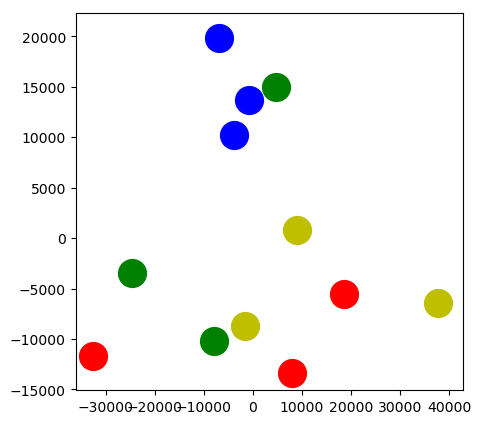

In [20]:
# Make a bunch of 2D scatterplots instead of one 3D scatterplot

for combo in [(0,1), (0,2), (1,2)]:
    fig=plt.figure(figsize=(5,5), dpi=100)
    ax=fig.gca()
    for i, j in zip(experimental_groups, 'rygb'):
        xs=components_df.loc[experimental_groups[i], combo[0]].values
        ys=components_df.loc[experimental_groups[i], combo[1]].values
    
        ax.scatter(xs, ys, c=j, s=400)
        fig.savefig('../Results/2d_pca_{}.png'.format(combo))

# 4. One-way ANOVA/F-test on 4 conditions

In [21]:
experimental_groups_expression={}
for condition in experimental_groups:
    experimental_groups_expression[condition]=present_transcripts_df[experimental_groups[condition]].T

In [22]:
F, p=f_oneway(experimental_groups_expression['Control'], 
               experimental_groups_expression['IL2'],
               experimental_groups_expression['IL15'],
               experimental_groups_expression['IL21'], axis=0)

In [23]:
len(F)

21794

In [24]:
transcripts=list(present_transcripts_df.index)

In [25]:
F_p_df=pd.DataFrame(index=transcripts, data=zip(F, p), columns=['F', 'p'])

In [26]:
F_p_df

,F,p
209023_s_at,1.847607,0.216772
212130_x_at,40.969880,0.000033
219328_at,28.600200,0.000126
219204_s_at,2.534313,0.130305
222413_s_at,4.886073,0.032370
...,...,...
220940_at,0.522243,0.678922
232221_x_at,1.632766,0.257287
1556336_at,1.562525,0.272468
203966_s_at,4.412782,0.041372


# 5. Benjamini-Hochberg step up correction

In [27]:
bh=multipletests(p, alpha=0.01, method='fdr_bh')
F_p_df['reject null']=bh[0]
F_p_df['corrected p']=bh[1]

In [28]:
diff_exp_genes_df=F_p_df.loc[F_p_df['reject null']]

In [29]:
diff_exp_genes_list=list(diff_exp_genes_df.index)

In [30]:
len(diff_exp_genes_list)

1844

# 5. Diff-exp A: Filter by fold change (No post-hoc)

## Calculating fold change vs control

In [31]:
#Calculate mean by experimental group
condition_means={}
condition_means_diffexp={}

for i in experimental_groups:
    condition_means_diffexp[i]=present_transcripts_df.loc[diff_exp_genes_list,experimental_groups[i]].T.mean()
    condition_means[i]=present_transcripts_df.loc[:, experimental_groups[i]].T.mean()    
    
condition_means_df=pd.DataFrame(condition_means)
condition_means_diffexp_df=pd.DataFrame(condition_means_diffexp)

In [32]:
present_transcripts_df.loc[:, experimental_groups['IL2']].T.mean()/present_transcripts_df.loc[:, experimental_groups['Control']].T.mean() 

209023_s_at    0.758839
212130_x_at    1.679052
219328_at      2.228288
219204_s_at    0.802378
222413_s_at    0.653776
                 ...   
220940_at      0.719643
232221_x_at    1.096145
1556336_at     0.694475
203966_s_at    0.768472
224687_at      1.020165
Length: 21794, dtype: float64

In [33]:
#Calculate fold change
fold_change_dict={}
for i in condition_means_df:
    fold_change_dict[i]=condition_means_df[i]/condition_means_df['Control']
fold_change_df=pd.DataFrame(fold_change_dict)

In [34]:
fold_change_df

,Control,IL2,IL15,IL21
209023_s_at,1.0,0.758839,0.871505,0.936272
212130_x_at,1.0,1.679052,1.504941,1.095774
219328_at,1.0,2.228288,2.110422,1.096774
219204_s_at,1.0,0.802378,0.901308,1.014507
222413_s_at,1.0,0.653776,0.734314,0.625827
...,...,...,...,...
220940_at,1.0,0.719643,0.826587,0.884999
232221_x_at,1.0,1.096145,0.892649,0.861497
1556336_at,1.0,0.694475,0.773204,0.945580
203966_s_at,1.0,0.768472,0.933681,0.901537


## Filter for fold change magnitude

In [35]:
diffexp_fold_change={}

for i in fold_change_df:
    
    if not i=='Control':
        diffexp_fold_change[i]={'up':[],
                      'dn':[]}
        
        #Filter for significance
        for j in diff_exp_genes_list:
            
            fold_change=fold_change_df.loc[j, i]
            
            if fold_change > 2:
                diffexp_fold_change[i]['up'].append(j)
                
            elif fold_change < 0.5:
                diffexp_fold_change[i]['dn'].append(j)

In [205]:
print("Differentially expressed probes in each group:")
for i in diffexp_fold_change:
    for j in diffexp_fold_change[i]:
        print ('{}_{}: {}'.format(i, j, len(diffexp_fold_change[i][j])))

Differentially expressed probes in each group:
IL2_up: 393
IL2_dn: 243
IL15_up: 352
IL15_dn: 217
IL21_up: 39
IL21_dn: 7


In [38]:
#Change probe names to gene names

diffexp_genes_fold_change={}
for i in diffexp_fold_change:
    diffexp_genes_fold_change[i]={}
    for j in diffexp_fold_change[i]:
        diffexp_genes_fold_change[i][j]=set()
        for probe in diffexp_fold_change[i][j]:
            if type(probe_key[probe])==list:
                for gene in probe_key[probe]:
                    diffexp_genes_fold_change[i][j].add(gene)

In [206]:
print("Differentially expressed genes in each group")

for i in diffexp_genes_fold_change:
    for j in diffexp_genes_fold_change[i]:
        print('{}_{}: {}'.format(i, j, len(diffexp_genes_fold_change[i][j])))

Differentially expressed genes in each group
IL2_up: 346
IL2_dn: 197
IL15_up: 312
IL15_dn: 182
IL21_up: 32
IL21_dn: 8


In [42]:
from matplotlib_venn import venn3

In [43]:
venn_dict=dict(zip(diffexp_fold_change.keys(), [diffexp_fold_change[i]['up']+diffexp_fold_change[i]['dn'] for i in diffexp_fold_change]))

up_venn_dict=dict(zip(diffexp_fold_change.keys(), [diffexp_fold_change[i]['up'] for i in diffexp_fold_change]))
dn_venn_dict=dict(zip(diffexp_fold_change.keys(), [diffexp_fold_change[i]['dn'] for i in diffexp_fold_change]))

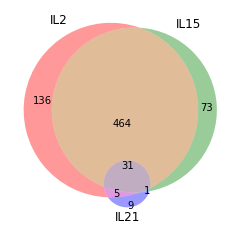

In [44]:
venn3(subsets=[set(venn_dict[condition]) for condition in venn_dict], set_labels=venn_dict.keys())

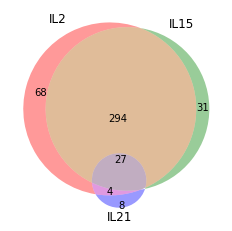

In [45]:
venn3(subsets=[set(up_venn_dict[condition]) for condition in venn_dict], set_labels=venn_dict.keys())

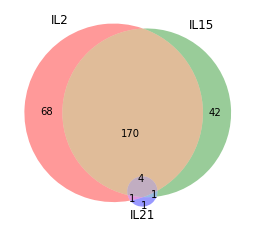

In [46]:
venn3(subsets=[set(dn_venn_dict[condition]) for condition in venn_dict], set_labels=venn_dict.keys())

# Calculate Pearson Correlation

In [84]:
#Create pearson correlation coefficient matrix between columns of a matrix
def matrix_pearson(df):
    pearsons={}
    pvals={}
    for column0 in df:
        pearsons[column0]=[]
        pvals[column0]=[]
        for column1 in df:
                r, p=pearsonr(df[column0], df[column1])
                pearsons[column0].append(r)
                pvals[column0].append(p)
    return(pd.DataFrame(pearsons), pd.DataFrame(pvals, dtype=float))

In [85]:
pearson, p=matrix_pearson(present_transcripts_df)

In [86]:
df=pd.DataFrame(np.random.randint(0,100, size=(100,6)), columns=list('abcdef'))

In [87]:
matrix_pearson(df)

(          a         b         c         d         e         f
 0  1.000000 -0.097052 -0.053283 -0.028133 -0.166925 -0.095683
 1 -0.097052  1.000000  0.118443  0.027028  0.088959  0.085062
 2 -0.053283  0.118443  1.000000 -0.029784 -0.021100 -0.072639
 3 -0.028133  0.027028 -0.029784  1.000000 -0.072406  0.075300
 4 -0.166925  0.088959 -0.021100 -0.072406  1.000000  0.035114
 5 -0.095683  0.085062 -0.072639  0.075300  0.035114  1.000000,
           a         b         c         d         e         f
 0  0.000000  0.336760  0.598539  0.781126  0.096928  0.343650
 1  0.336760  0.000000  0.240524  0.789523  0.378778  0.400093
 2  0.598539  0.240524  0.000000  0.768631  0.834943  0.472630
 3  0.781126  0.789523  0.768631  0.000000  0.474057  0.456519
 4  0.096928  0.378778  0.834943  0.474057  0.000000  0.728715
 5  0.343650  0.400093  0.472630  0.456519  0.728715  0.000000)

In [88]:
pearson.columns=[sample_key_abb[i] for i in pearson.columns]

In [89]:
pearson.index=pearson.columns

In [90]:
pearson

,Control 1,Control 2,Control 3,Activated with IL2 rep 1,Activated with IL2 rep 2,Activated with IL2 rep 3,Activated with IL15 rep 1,Activated with IL15 rep 2,Activated with IL15 rep 3,Activated with IL21 rep 1,Activated with IL21 rep 2,Activated with IL21 rep 3
Control 1,1.000000,0.989744,0.988936,0.977341,0.973549,0.978273,0.981910,0.981914,0.975216,0.991129,0.985994,0.988264
Control 2,0.989744,1.000000,0.994700,0.980841,0.982749,0.976951,0.976290,0.978530,0.977150,0.991417,0.992126,0.990191
Control 3,0.988936,0.994700,1.000000,0.983215,0.986236,0.980479,0.978448,0.981897,0.982607,0.995571,0.992700,0.994237
Activated with IL2 rep 1,0.977341,0.980841,0.983215,1.000000,0.995675,0.995875,0.992988,0.994323,0.996377,0.987676,0.987405,0.988361
Activated with IL2 rep 2,0.973549,0.982749,0.986236,0.995675,1.000000,0.991585,0.988380,0.990984,0.994884,0.987526,0.986091,0.987943
Activated with IL2 rep 3,0.978273,0.976951,0.980479,0.995875,0.991585,1.000000,0.995383,0.997292,0.993072,0.985652,0.985144,0.984963
Activated with IL15 rep 1,0.981910,0.976290,0.978448,0.992988,0.988380,0.995383,1.000000,0.997625,0.992135,0.985720,0.981662,0.985402
Activated with IL15 rep 2,0.981914,0.978530,0.981897,0.994323,0.990984,0.997292,0.997625,1.000000,0.992993,0.987470,0.985003,0.986448
Activated with IL15 rep 3,0.975216,0.977150,0.982607,0.996377,0.994884,0.993072,0.992135,0.992993,1.000000,0.988542,0.985956,0.989857
Activated with IL21 rep 1,0.991129,0.991417,0.995571,0.987676,0.987526,0.985652,0.985720,0.987470,0.988542,1.000000,0.994592,0.997699


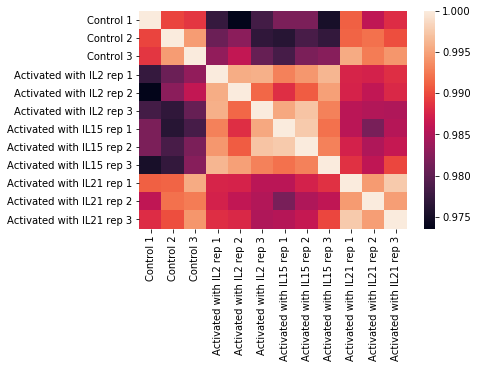

In [91]:
sns.heatmap(pearson)
plt.savefig('../Results/Pearson_clustermap.png')

# Compare with Gene Sets

In [56]:
gene_sets={
    'GSE8685_IL15_ACT_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL15_IL21_up',
    'GSE8685_IL15_ACT_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL15_IL21_dn',
    'GSE8685_IL2_ACT_IL2_STARVED_VS_IL15_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL15_Control_dn',
    'GSE8685_IL2_ACT_IL2_STARVED_VS_IL15_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL15_Control_up',
    'GSE8685_IL2_ACT_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL2_IL21_dn',
    'GSE8685_IL2_ACT_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL2_IL21_up',
    'GSE8685_IL2_STARVED_VS_IL15_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL15_Control_dn',
    'GSE8685_IL2_STARVED_VS_IL15_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL15_Control_up',
    'GSE8685_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL21_Control_dn',
    'GSE8685_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL21_Control_up',
    'GSE8685_IL2_STARVED_VS_IL2_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL2_Control_dn',
    'GSE8685_IL2_STARVED_VS_IL2_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL2_Control_up',
    'IL15_UP.V1_DN':'IL15_Control_dn',
    'IL15_UP.V1_UP':'IL15_Control_up',
    'IL21_UP.V1_DN':'IL21_Control_dn',
    'IL21_UP.V1_UP':'IL21_Control_up',
    'IL2_UP.V1_DN':'IL2_Control_dn',
    'IL2_UP.V1_UP':'IL2_Control_up',
    'MARZEC_IL2_SIGNALING_DN': 'IL2_Control_dn',
    'MARZEC_IL2_SIGNALING_UP':'IL2_Control_up',
}

In [57]:
gene_sets_dict=pickle.load(open('msigdb_marzec_gene_sets.p', 'rb'))

In [58]:
gene_sets_dict

{'GSE8685_IL15_ACT_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_DN': ['UGCG',
  'IDH2',
  'RPS14',
  'TRIB2',
  'RPL19',
  'SMURF2',
  'LPIN1',
  'B4GALT3',
  'SULT1B1',
  'ADPRHL1',
  'COQ3',
  'IBTK',
  'STARD7',
  'HERC3',
  'CUL9',
  'SELENOP',
  'NOP14',
  'SLC25A10',
  'SMOC1',
  'FAM102A',
  'RAPGEF2',
  'AGGF1',
  'RAD50',
  'ID2',
  'SGIP1',
  'ZNF91',
  'RND3',
  'ARL2',
  'VPS37B',
  'AICDA',
  'SATB1',
  'PDLIM5',
  'NFE2L2',
  'CIAO1',
  'ADRB2',
  'SNX12',
  'MFNG',
  'AQP9',
  'MTSS1',
  'SERPINA6',
  'VPREB3',
  'SPART',
  'HDAC5',
  'PIM2',
  'KLHDC2',
  'TNS4',
  'ATP5F1B',
  'TTC13',
  'LSG1',
  'MFSD2B',
  'POLR1C',
  'SEC16A',
  'NUP210',
  'MICU1',
  'TCF7',
  'FNTB',
  'ZFP14',
  'MAMDC4',
  'DPPA2',
  'RIPOR2',
  'SNN',
  'MPP6',
  'CDYL2',
  'PPARGC1B',
  'WDR88',
  'AKT2',
  'DNAJC3',
  'CALML3',
  'ATPAF1',
  'ST8SIA6',
  'PRPF31',
  'C18orf32',
  'IKZF1',
  'RNF157',
  'PIGV',
  'RPL12',
  'RPS5',
  'NSA2',
  'MRPL46',
  'CHCHD3',
  'CD4',
  'GAL3ST3',
  'R

In [59]:
from matplotlib_venn import venn2

IL15_Control_dn
IL15_Control_up
IL15_Control_dn
IL15_Control_up
IL21_Control_dn
IL21_Control_up
IL2_Control_dn
IL2_Control_up
IL15_Control_dn
IL15_Control_up
IL21_Control_dn
IL21_Control_up
IL2_Control_dn
IL2_Control_up
IL2_Control_dn
IL2_Control_up


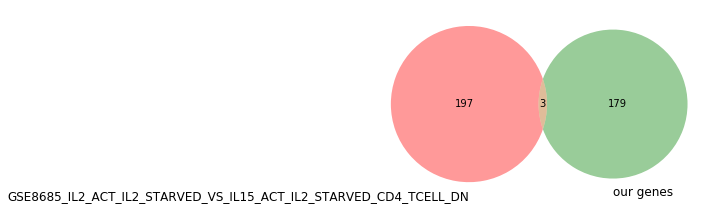

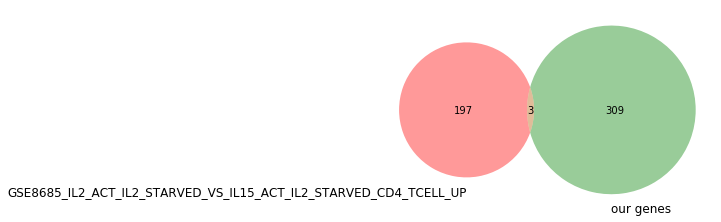

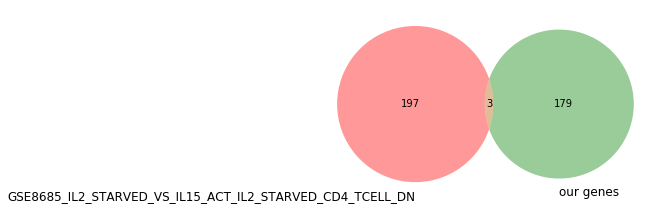

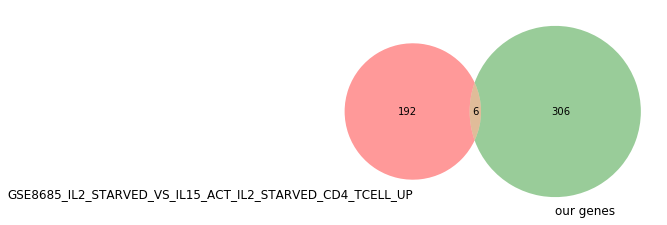

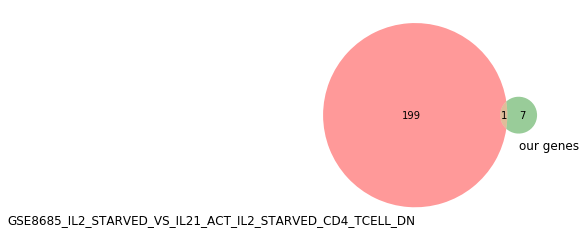

...

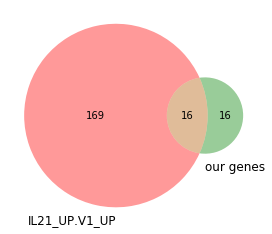

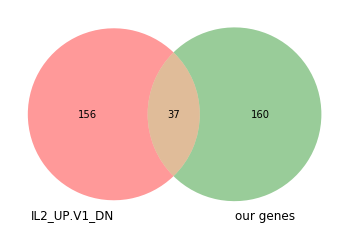

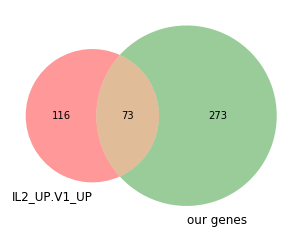

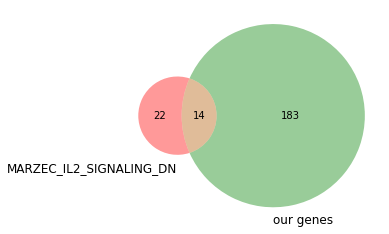

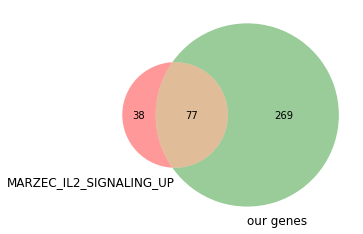

In [60]:
for gene_set in gene_sets:
    condition=gene_sets[gene_set].split('_')
    up_or_dn=condition[2]
    if condition[1] == 'Control':
        gene_set_genes=set(gene_sets_dict[gene_set])
        diff_exp_genes=set(diffexp_genes_fold_change[condition[0]][up_or_dn])
        print(gene_sets[gene_set])
        fig=plt.figure()
        ax=plt.gca()
        venn2([gene_set_genes, diff_exp_genes], set_labels=[gene_set, 'our genes'], ax=ax)

# Diff-exp B: Post-Hoc Analysis by using Pairwise Tukey

In [61]:
def tukeyhsd_get_significant_comparisons(tukeyhsd_results, include_CI=True, only_sig_comparisons=True):
    
    summary_df=pd.DataFrame(tukeyhsd_results._results_table.data[1:], columns=tukeyhsd_results._results_table.data[0])
    
    desired_comparisons = [True] if only_sig_comparisons else [True, False]    
    
    a=summary_df.loc[:,['p-adj', 'reject']]
    
    if include_CI:
        
        a['CI'] = [[i[0] for i in zip(summary_df.loc[j, ['lower', 'upper']])] for j in summary_df.index]
        
    a.index=[i+'_'+j for i,j in summary_df.loc[:,['group1', 'group2']].values]
        
    return a.loc[[True if i in desired_comparisons else False for i in summary_df['reject']]]

In [63]:
post_hoc_diff_dict={}
for transcript in diff_exp_genes_list:
    
    tukey_summary=pairwise_tukeyhsd(present_transcripts_df.loc[transcript].to_numpy(), ['Control']*3+['IL2']*3+['IL15']*3+['IL21']*3, alpha=0.01)
    tukey_results=tukeyhsd_get_significant_comparisons(tukey_summary, include_CI=True)
    
    for comparison in tukey_results.index:
        if not comparison in post_hoc_diff_dict:
            post_hoc_diff_dict[comparison]={}
        post_hoc_diff_dict[comparison][transcript]=tukey_results.loc[comparison, 'p-adj']

In [102]:
post_hoc_diff_df=pd.DataFrame(post_hoc_diff_dict)

In [209]:
print("Significant differentially expressed genes after post hoc analysis:")

for condition in post_hoc_diff_dict:
    print('{}: {} genes'.format(condition, len(post_hoc_diff_dict[condition])))

Significant differentially expressed genes after post hoc analysis:
Control_IL15: 1678 genes
Control_IL2: 1737 genes
IL15_IL21: 1446 genes
IL2_IL21: 1519 genes
Control_IL21: 192 genes
IL15_IL2: 44 genes


### Filter for Fold Change 2 or higher

In [210]:
post_hoc_fold_change_dict={}
for comparison in post_hoc_diff_dict:
    condA=comparison.split('_')[0]
    condB=comparison.split('_')[1]
    post_hoc_fold_change_dict[comparison]=present_transcripts_df.loc[:,experimental_groups[condB]].T.mean()/present_transcripts_df.loc[:,experimental_groups[condA]].T.mean()
post_hoc_fold_change_df=pd.DataFrame(post_hoc_fold_change_dict)

In [211]:
post_hoc_fold_change_df

,Control_IL15,Control_IL2,IL15_IL21,IL2_IL21,Control_IL21,IL15_IL2
209023_s_at,0.871505,0.758839,1.074316,1.233822,0.936272,0.870723
212130_x_at,1.504941,1.679052,0.728118,0.652615,1.095774,1.115693
219328_at,2.110422,2.228288,0.519694,0.492205,1.096774,1.055850
219204_s_at,0.901308,0.802378,1.125594,1.264375,1.014507,0.890237
222413_s_at,0.734314,0.653776,0.852260,0.957250,0.625827,0.890322
...,...,...,...,...,...,...
220940_at,0.826587,0.719643,1.070666,1.229775,0.884999,0.870620
232221_x_at,0.892649,1.096145,0.965102,0.785933,0.861497,1.227969
1556336_at,0.773204,0.694475,1.222937,1.361575,0.945580,0.898178
203966_s_at,0.933681,0.768472,0.965573,1.173155,0.901537,0.823057


In [212]:
diffexp_fold_change_ph={}
  
for condition in post_hoc_diff_dict:

    diffexp_fold_change_ph[condition]={
        'up':[],
        'dn':[]
    }
    for transcript in post_hoc_diff_dict[condition]:
        
        #Note that this fold change is for condition 2 relative to condition 1 in 1_2
        fold_change=post_hoc_fold_change_df.loc[transcript, condition]
        if fold_change > 2:
            diffexp_fold_change_ph[condition]['up'].append(transcript)

        elif fold_change < 0.5:
            diffexp_fold_change_ph[condition]['dn'].append(transcript)


In [213]:
#Change probe names to gene names
diffexp_genes_fold_change_ph={}

for i in diffexp_fold_change_ph:
    
    diffexp_genes_fold_change_ph[i]={}
    
    for j in diffexp_fold_change_ph[i]:
        
        diffexp_genes_fold_change_ph[i][j]=set()
        
        for probe in diffexp_fold_change_ph[i][j]:
            
            if type(probe_key[probe])==list:
                
                for gene in probe_key[probe]:
                    diffexp_genes_fold_change_ph[i][j].add(gene)

In [75]:
for condition in diffexp_genes_fold_change_ph:
    for up_or_dn in diffexp_genes_fold_change_ph[condition]:
        print('{}_{}: {} genes'.format(condition, up_or_dn, len(diffexp_genes_fold_change_ph[condition][up_or_dn])))

Control_IL15_up: 309 genes
Control_IL15_dn: 181 genes
Control_IL2_up: 345 genes
Control_IL2_dn: 197 genes
IL15_IL21_up: 110 genes
IL15_IL21_dn: 179 genes
IL2_IL21_up: 139 genes
IL2_IL21_dn: 208 genes
Control_IL21_up: 20 genes
Control_IL21_dn: 7 genes
IL15_IL2_up: 0 genes
IL15_IL2_dn: 0 genes


## Compare with gene sets

In [214]:
gene_sets

{'GSE8685_IL15_ACT_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL15_IL21_up',
 'GSE8685_IL15_ACT_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL15_IL21_dn',
 'GSE8685_IL2_ACT_IL2_STARVED_VS_IL15_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL15_Control_dn',
 'GSE8685_IL2_ACT_IL2_STARVED_VS_IL15_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL15_Control_up',
 'GSE8685_IL2_ACT_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL2_IL21_dn',
 'GSE8685_IL2_ACT_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL2_IL21_up',
 'GSE8685_IL2_STARVED_VS_IL15_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL15_Control_dn',
 'GSE8685_IL2_STARVED_VS_IL15_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL15_Control_up',
 'GSE8685_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL21_Control_dn',
 'GSE8685_IL2_STARVED_VS_IL21_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL21_Control_up',
 'GSE8685_IL2_STARVED_VS_IL2_ACT_IL2_STARVED_CD4_TCELL_DN': 'IL2_Control_dn',
 'GSE8685_IL2_STARVED_VS_IL2_ACT_IL2_STARVED_CD4_TCELL_UP': 'IL2_Control_up',
 'IL15_U

IL15_Control_dn
IL15_Control_up
IL15_Control_dn
IL15_Control_up
IL21_Control_dn
IL21_Control_up
IL2_Control_dn
IL2_Control_up
IL15_Control_dn
IL15_Control_up
IL21_Control_dn
IL21_Control_up
IL2_Control_dn
IL2_Control_up
IL2_Control_dn
IL2_Control_up


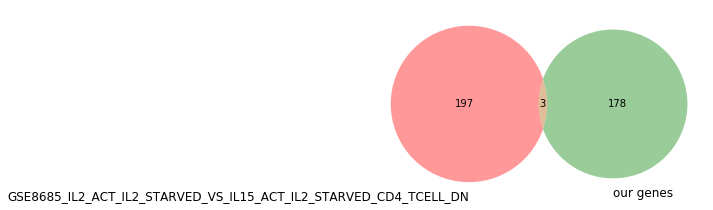

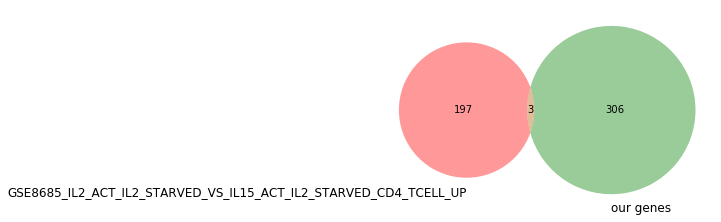

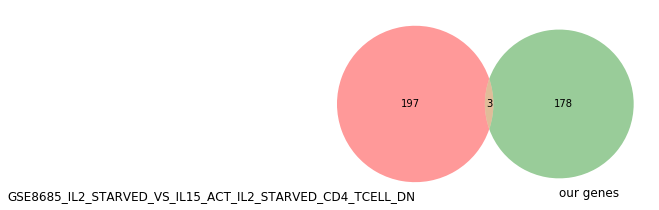

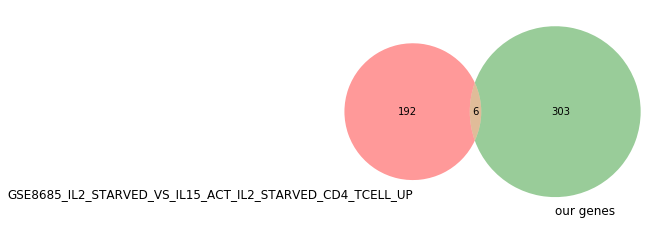

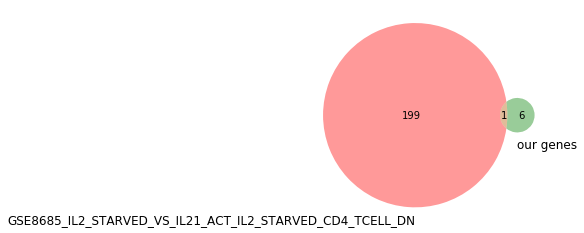

...

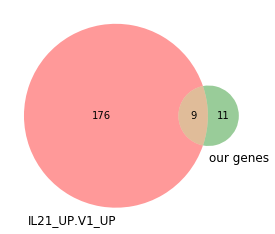

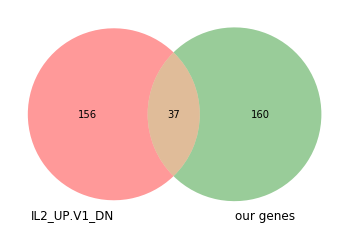

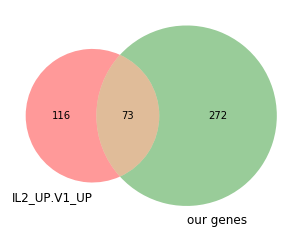

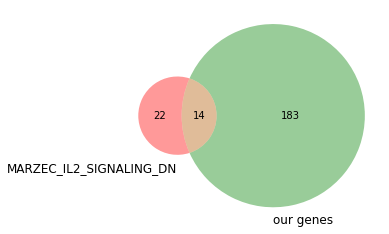

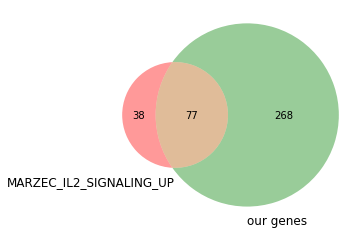

In [79]:
for gene_set in gene_sets:
    condition=gene_sets[gene_set].split('_')
    up_or_dn=condition[2]
    
    #Only comparing fold change from control
    if condition[1] == 'Control':
        gene_set_genes=set(gene_sets_dict[gene_set])
        diff_exp_genes=set(diffexp_genes_fold_change_ph['{}_{}'.format(condition[1], condition[0])][up_or_dn])
        print(gene_sets[gene_set])
        fig=plt.figure()
        ax=plt.gca()
        venn2([gene_set_genes, diff_exp_genes], set_labels=[gene_set, 'our genes'], ax=ax)

# Compare ANOVA with no post-hoc analysis to ANVOA with post-hoc analysis (Remove ?)

In [83]:
diffexp_fold_change

{'IL2': {'up': ['219328_at',
   '241402_at',
   '214637_at',
   '204118_at',
   '217997_at',
   '203410_at',
   '1554239_s_at',
   '210229_s_at',
   '204060_s_at',
   '213097_s_at',
   '208891_at',
   '210118_s_at',
   '239331_at',
   '204014_at',
   '209193_at',
   '220966_x_at',
   '224745_x_at',
   '219006_at',
   '226430_at',
   '225177_at',
   '227517_s_at',
   '217631_at',
   '203068_at',
   '203372_s_at',
   '204348_s_at',
   '229021_at',
   '226702_at',
   '209305_s_at',
   '225857_s_at',
   '213523_at',
   '208264_s_at',
   '225853_at',
   '226034_at',
   '225342_at',
   '203823_at',
   '202387_at',
   '207844_at',
   '1557905_s_at',
   '205284_at',
   '212192_at',
   '225291_at',
   '205965_at',
   '211686_s_at',
   '221185_s_at',
   '227410_at',
   '229437_at',
   '209875_s_at',
   '36554_at',
   '235497_at',
   '226837_at',
   '227804_at',
   '209180_at',
   '222270_at',
   '206653_at',
   '224714_at',
   '209687_at',
   '227477_at',
   '211450_s_at',
   '216048_s_at',
   '

Control_IL15_up
Control_IL15_dn
Control_IL2_up
Control_IL2_dn
Control_IL21_up
Control_IL21_dn


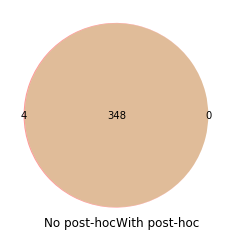

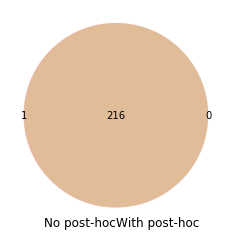

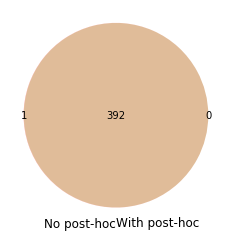

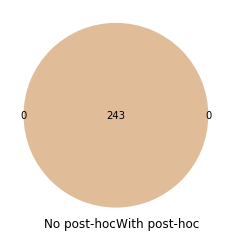

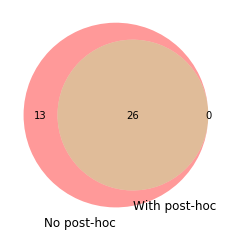

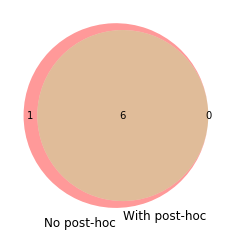

In [94]:
for comparison in diffexp_fold_change_ph:
    condition=comparison.split('_')
    if condition[0]=='Control':
        for up_or_dn in ['up', 'dn']:
        
            deg_a=set(diffexp_fold_change[condition[1]][up_or_dn])
            deg_b=set(diffexp_fold_change_ph[comparison][up_or_dn])
            
            print('{}_{}'.format(comparison, up_or_dn))
            
            fig=plt.figure()
            ax=plt.gca()
            venn2([deg_a, deg_b], set_labels=['No post-hoc', 'With post-hoc'], ax=ax)            

# Create Volcano Plots (Using post-hoc p-values)

In [132]:
#These volcano plots look unusual because we have only plotted genes we have already determined to be significant 
#through Tukey.

for condition in post_hoc_fold_change_df:
    
    volcano_plot_df=pd.DataFrame([pd.Series(-np.log10(post_hoc_fold_change_df[condition]), name='-log(Fold Change)'), 
                                  pd.Series(-np.log10(post_hoc_diff_df[condition]), name='-log(p)')]
                                 )
    
    volcano_plot_df.columns=[probe_key[i] for i in volcano_plot_df.columns]
    
    volcano_plot_df=volcano_plot_df.T
    
    volcano_plot_df['hover_text_labels']=volcano_plot_df.index
    
    fig=px.scatter(volcano_plot_df, x='-log(Fold Change)', y='-log(p)', hover_data=['hover_text_labels'], title=condition)
    fig.show()

# Probe IL2/15/21 Essentiality in DepMap/CCLE

In [27]:
dm_sample_info=pd.read_csv('../Data/dm_sample_info.csv', index_col=0)
dm_gene_expression=pd.read_csv('../Data/CCLE_expression.csv', index_col=0)

In [28]:
cks=['IL2', 'IL15', 'IL21']

In [29]:
lineage=dm_sample_info['lineage']

In [30]:
dm_gene_expression.columns=[i.split(' ')[0] for i in dm_gene_expression.columns]

In [31]:
dm_gene_expression_oi=dm_gene_expression.loc[:,cks]

In [33]:
dependency=pd.read_csv('../Data/CRISPR_gene_dependency.csv', index_col=0)

In [34]:
dependency

,IL21,IL2,IL15
DepMap_ID,,,
ACH-000001,0.036455,0.044963,0.005627
ACH-000004,0.024919,0.077867,0.019526
ACH-000005,0.005582,0.025339,0.033685
ACH-000007,0.012397,0.015410,0.015570
ACH-000009,0.053033,0.011592,0.014057
...,...,...,...
ACH-002508,0.008638,0.053809,0.053285
ACH-002510,0.028193,0.008510,0.058078
ACH-002511,0.020347,0.053827,0.016426


### Make one histogram with all cytokines

In [35]:
#append values into a format plotly express will take

values=[]
labels=[]
index=[]

for ck in cks:
    values+=[*dm_gene_expression[ck].values]
    labels+=[ck]*dm_gene_expression[ck].shape[0]

In [36]:
big_px_df=pd.DataFrame([values, labels], index=['gene_expression', 'gene'], dtype=float)

In [37]:
px.histogram(data_frame=big_px_df.T, x='gene_expression', color='gene', barmode='overlay', title="Average Cytokine Gene Expression")

In [41]:
dm_gene_expression

,IL21,IL2,IL15
ACH-001113,0.0,0.000000,2.028569
ACH-001289,0.0,0.000000,0.137504
ACH-001339,0.0,0.000000,0.565597
ACH-001538,0.0,0.000000,2.367371
ACH-000242,0.0,0.000000,0.124328
...,...,...,...
ACH-000750,0.0,0.000000,1.238787
ACH-000285,0.0,0.028569,0.014355
ACH-001858,0.0,0.000000,2.691534
ACH-001997,0.0,0.000000,2.350497


In [48]:
dm_ge_x_lineage=dm_gene_expression.groupby(lineage).mean()

In [50]:
values=[]
labels=[]
index=[]

for ck in cks:
    values+=[*dm_ge_x_lineage[ck].values]
    labels+=[ck]*dm_ge_x_lineage[ck].shape[0]
    index+=[*dm_ge_x_lineage.index]

In [51]:
big_px_df=pd.DataFrame([values, labels, index], index=['average_gene_expression', 'gene', 'tissue_lineage'], dtype=float)

In [52]:
px.bar(data_frame=big_px_df.T, x='tissue_lineage', y='average_gene_expression', color='gene', barmode='overlay', title='Average Cytokine Gene Expression by Tissue Lineage', height=1000)

In [53]:
#append values into a format plotly express will take

values=[]
labels=[]
index=[]

for ck in cks:
    values+=[*dependency[ck].values]
    labels+=[ck]*dependency[ck].shape[0]

In [54]:
big_px_df=pd.DataFrame([values, labels], index=['gene_dependency_score', 'gene'], dtype=float)

In [55]:
px.histogram(data_frame=big_px_df.T, x='gene_dependency_score', color='gene', barmode='overlay', title='Cytokine Gene Dependency Score')

In [57]:
dm_dep_x_lineage=dependency.groupby(lineage).mean()

In [58]:
values=[]
labels=[]
index=[]

for ck in cks:
    values+=[*dm_dep_x_lineage[ck].values]
    labels+=[ck]*dm_dep_x_lineage[ck].shape[0]
    index+=[*dm_dep_x_lineage.index]

In [59]:
big_px_df=pd.DataFrame([values, labels, index], index=['average_gene_dependency', 'gene', 'tissue_lineage'], dtype=float)

In [60]:
px.bar(data_frame=big_px_df.T, x='tissue_lineage', y='average_gene_dependency', color='gene', barmode='overlay', title='Average Cytokine Gene  Dependency Score by Tissue Lineage', height=1000)

### or make 3 different histograms - to see different things

In [62]:
dm_gene_expression=dm_gene_expression.T

In [63]:
for ck in cks:

    fig=px.histogram(data_frame=dm_gene_expression.loc[ck].to_frame(), x=ck, range_x=[0,8], nbins=200, title='{}: {}'.format(ck, 'Gene Expression'), labels={ck: 'Gene Expression Value'})

    fig.show()
    
    fig=px.bar(dm_gene_expression.T.groupby(lineage).mean().loc[:, ck], title='Average {} Expression by Tissue Lineage'.format(ck))
    fig.show()

In [64]:
dependency=dependency.T

In [65]:
for ck in cks:

    fig=px.histogram(x=dependency.loc[ck].values, range_x=[0,1], nbins=200, title='{}: {}'.format(ck, 'Dependency'))

    fig.show()
    
    fig=px.bar(dependency.T.groupby(lineage).mean().loc[:, ck], title='Average {} Dependency by Tissue Lineage'.format(ck))
    fig.show()